<a href="https://colab.research.google.com/github/gcosma/RSS_Course_Code/blob/main/ActivityLime_and_Shap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Install and import packages**

In [1]:
# install packages
!pip install lime
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 5.2 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=1542f2460571dda2a5f6e82520a99f65854c5d245ea07e26ba143a1e78ab5254
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 569 kB 5.1 MB/s 


import packages:

In [2]:
# import packages
import sklearn
import sklearn.datasets
import sklearn.ensemble
import numpy as np
import lime
import lime.lime_tabular
from __future__ import print_function
import shap
import random
import pandas as pd

# **Dataset**

Load data:

In [3]:
# codes from Part 1

# load the csv table of the data
df = pd.read_csv("https://raw.githubusercontent.com/fairlearn/talks/main/2021_scipy_tutorial/data/diabetic_preprocessed.csv")
df.head()

# addressing smaller group sizes
df = df.query("gender != 'Unknown/Invalid'") # drop gender group Unknown/Invalid
df["race_all"] = df["race"] # retain the original race as race_all
df["race"] = df["race"].replace({"Asian": "Other", "Hispanic": "Other"}) # merge Asian+Hispanic+Other 

# our target variable is readmission within 30 days
target_variable = "readmit_30_days"
Y = df.loc[:, target_variable] # select column of readmit_30_days as prediction data


# drop the features that we don't want to use in our model
Xf = df.drop(columns=[
    "race",
    "race_all",
    "discharge_disposition_id",
    "readmitted",
    "readmit_binary",
    "readmit_30_days"
])

# expand the categorical features into 0/1 indicators ("dummies")
X = pd.get_dummies(Xf)

# Obtain the labels for the later use by the plot of LIME and SHAP
columnsName = X.columns
feature_names = [str(columnsName[i]) for i in range(len(columnsName))]  # feature labels
target_names = np.array(['Not readmit_30_days', 'Readmit_30_days']) # target labels

# print some instances' features
print('print some instances\' features:')
X.head()

print some instances' features:


,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_diagnoses,medicare,medicaid,had_emergency,had_inpatient_days,had_outpatient_days,...,A1Cresult_None,A1Cresult_Norm,insulin_Down,insulin_No,insulin_Steady,insulin_Up,change_Ch,change_No,diabetesMed_No,diabetesMed_Yes
0,1,41,0,1,1,False,False,False,False,False,...,1,0,0,1,0,0,0,1,1,0
1,3,59,0,18,9,False,False,False,False,False,...,1,0,0,0,0,1,1,0,0,1
2,2,11,5,13,6,False,False,False,True,True,...,1,0,0,1,0,0,0,1,0,1
3,2,44,1,16,7,False,False,False,False,False,...,1,0,0,0,0,1,1,0,0,1
4,1,51,0,8,5,False,False,False,False,False,...,1,0,0,0,1,0,1,0,0,1


## ***Use partial data for a fast runing***

In [4]:
# DataNum = X.shape[0] # use all data, runing slow
DataNum = 150 # use partial data for fast runing

Split data into train and test sets:

In [5]:
# obtain data we want to use (number of DataNum)
X = X[ : DataNum]
y = Y[ : DataNum]

# if you want False->0, and True->1, please uncomment this code
# X = X[ : DataNum] + 0
# y = Y[ : DataNum] + 0

# convert the data to ndarry
X = np.array(X)
y = np.array(y)

# split the data as train and test sets
train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(X, y, train_size=0.80)

Present some samples from the test set:

In [6]:
# convert ndarray to pandas.DataFrame for the test set
test_present = test.copy()
test_present = pd.DataFrame(test_present, columns=columnsName)

# print some instances from the test set
print('print some instances from the test set:')
test_present.head()

print some instances from the test set:


,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_diagnoses,medicare,medicaid,had_emergency,had_inpatient_days,had_outpatient_days,...,A1Cresult_None,A1Cresult_Norm,insulin_Down,insulin_No,insulin_Steady,insulin_Up,change_Ch,change_No,diabetesMed_No,diabetesMed_Yes
0,2,35,1,10,8,False,False,False,False,True,...,1,0,0,0,0,1,1,0,0,1
1,3,34,0,11,8,False,False,False,False,False,...,0,1,0,1,0,0,0,1,1,0
2,1,49,5,2,8,False,False,False,False,False,...,1,0,0,0,1,0,0,1,0,1
3,5,36,0,14,5,False,False,False,False,False,...,1,0,0,0,1,0,1,0,0,1
4,3,39,0,13,7,False,False,False,False,False,...,1,0,0,1,0,0,0,1,0,1


# **Training a model**

## ***Select a model***

Select a model for training and predicting, and change the value of CurrentModel with using below:

LR: LogisticRegression

SVM: svm.SVC

KNN: KNeighborsClassifier

RF: RandomForestClassifier

In [7]:
# [LR,SVM,KNN,RF]
CurrentModel = 'RF'

Train and fit the model:

In [8]:
# based on the selection, set the model
if CurrentModel == 'LR':
  model = sklearn.linear_model.LogisticRegression()
if CurrentModel == 'SVM':
  model = sklearn.svm.SVC(probability=True)
if CurrentModel == 'KNN':
  model = sklearn.neighbors.KNeighborsClassifier()
else:
  model = sklearn.ensemble.RandomForestClassifier(n_estimators=500)

# fit the model
model.fit(train, labels_train)

# compute the accuracy of prediction
sklearn.metrics.accuracy_score(labels_test, model.predict(test))

0.8666666666666667

# **Explaining**

## **LIME**

### ***Set which instance to explain for LIME***

Instances are just ordered from 0 to the length of the test set

In [9]:
# inID = np.random.randint(0, test.shape[0]) # just randomly select one for explaining if you like
inID = 0  # set which instance to explain in the test set

### ***Load the LIME explainer***

In [10]:
# Load the explainer
LIMEexplainer = lime.lime_tabular.LimeTabularExplainer(train, feature_names=columnsName, class_names=target_names, discretize_continuous=True)

### ***Explaining an instance***

In [11]:
# Explaining an instance
exp = LIMEexplainer.explain_instance(test[inID], model.predict_proba, num_features=train.shape[1], top_labels=0)
exp.show_in_notebook(show_table=True, show_all=False)

## **SHAP**

### ***Load Explainer***

In [12]:
# shapeExplainer, shap supports sklearn.ensemble, so RF can use TreeExplainer
if CurrentModel == 'RF':
  ShapExplainer = shap.TreeExplainer(model)
else: # shap does not support other sklearn models, so use KernelExplainer
  sub_sampled_train_data = shap.sample(train, 10, random_state=0) # use 10 samples of train data as background data, needed by KernelExplainer
  ShapExplainer = shap.KernelExplainer(model.predict_proba, sub_sampled_train_data)

# convert data to shap_values
shap_values_RF_test = ShapExplainer.shap_values(test)
shap_values_RF_train = ShapExplainer.shap_values(train)

### ***Explain all instances***

#### ****Force plot:****

In [13]:
# Explaining all instances
shap.initjs()
shap.force_plot(ShapExplainer.expected_value[0], shap_values_RF_test[0], feature_names = columnsName)

#### ****Evaluating feature importance:****

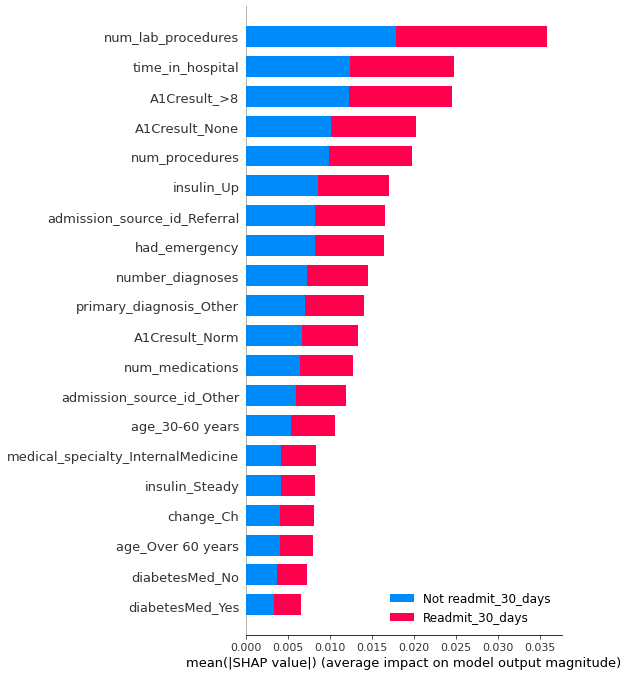

In [14]:
# Explaining all instances
shap.initjs()
shap.summary_plot(shap_values_RF_test, test, class_names = target_names, feature_names = columnsName)

### ***Explain one instances (inID)***

#### ****Set which instance to explain for SHAP****

Instances are just ordered from 0 to the length of the test set

In [15]:
# inID = np.random.randint(0, test.shape[0]) # just randomly select one for explaining if you like
inID = 0  # set which instance to explain in the test set

#### ****Waterfall plot:****

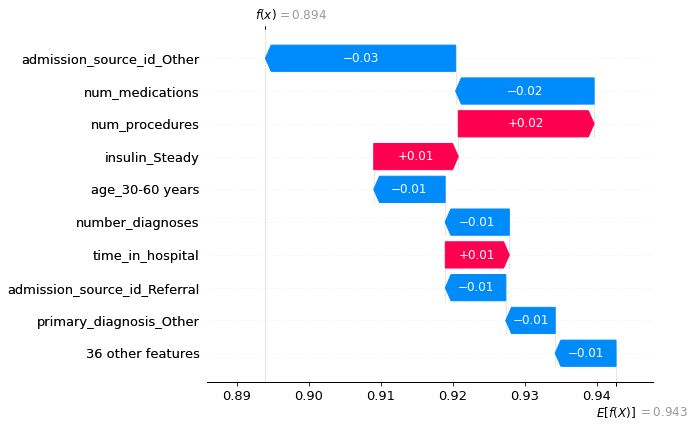

In [16]:
# Explaining one instance (inID)
shap.initjs()
shap.plots._waterfall.waterfall_legacy(ShapExplainer.expected_value[0], shap_values_RF_test[0][inID], feature_names = columnsName)

#### ****Force plot:****

In [17]:
# Explaining one instance (inID)
shap.initjs()
shap.force_plot(ShapExplainer.expected_value[0], shap_values_RF_test[0][inID], feature_names = columnsName)

#### ****Evaluating Feature importance (one instance, inID):****

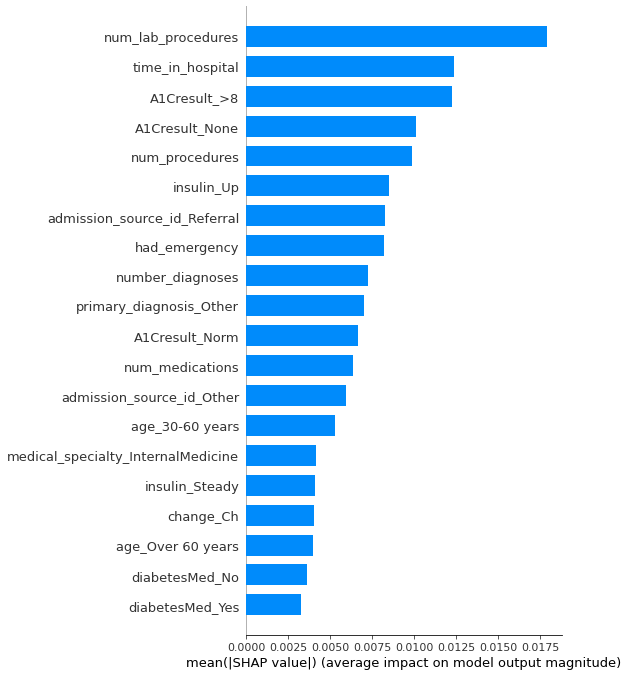

In [18]:
# Explaining one instance (inID)
shap.initjs()
shap.summary_plot(shap_values_RF_test[inID], test, plot_type="bar", class_names = target_names, feature_names = columnsName)

#### ****Feature influence or dependency (one instance, inID):****

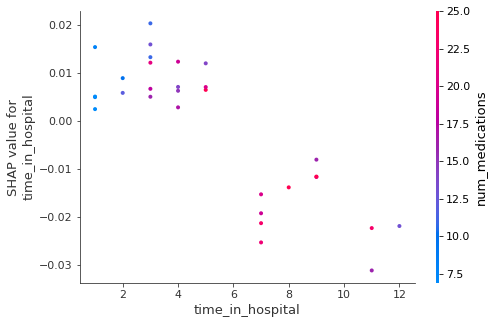

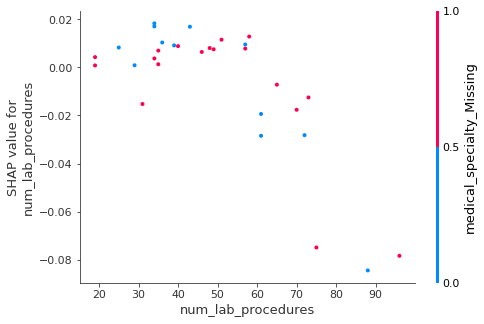

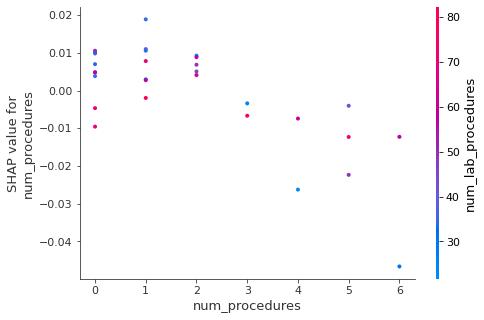

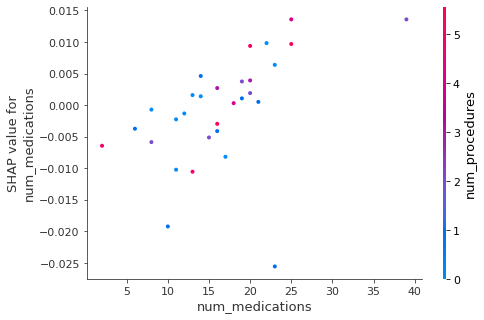

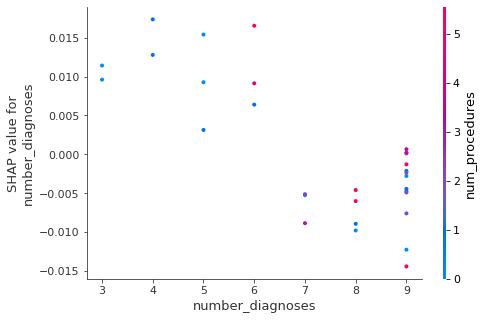

...

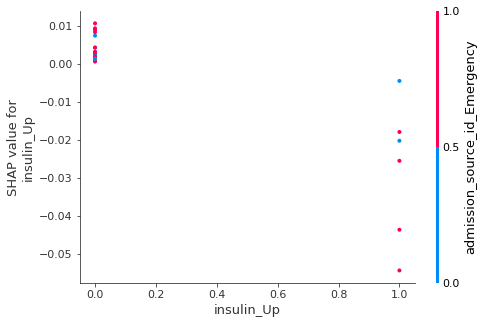

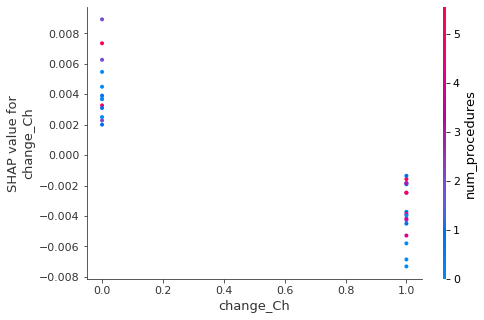

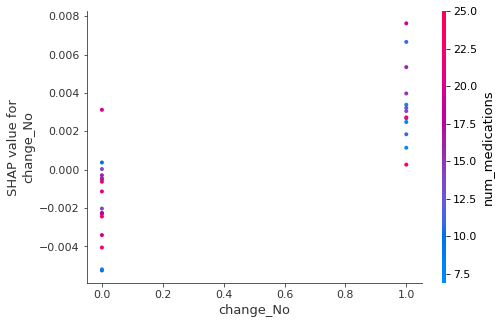

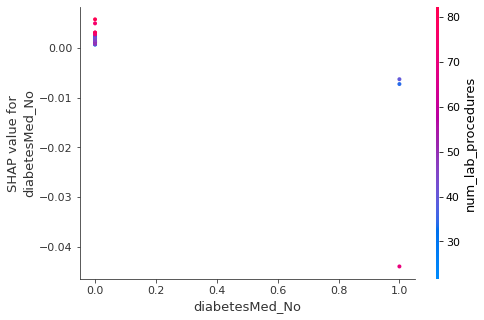

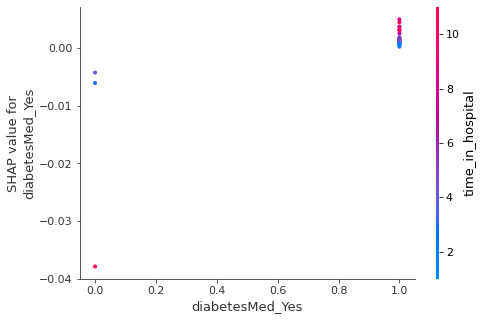

In [19]:
# Explaining one instance (inID)
# loop features for presenting
for coNa in columnsName:
  shap.initjs()
  shp_plt = shap.dependence_plot(coNa, shap_values_RF_test[inID], test, feature_names = columnsName)